In [196]:
# Bruno Vieira Ribeiro - 2022

# Exploring Pokémon Legends: Arceus reviews

**Pokémon Legends: Arceus** was released on January 28th, 2022 with a big promise: to change the pokémon formula. The games have been around since 1996 and together are the [highest-grossing video game franchise](https://www.titlemax.com/discovery-center/lifestyle/the-top-50-highest-grossing-video-game-franchises/) today. Ever since that first contact with the amazing Pokémon Red/Blue, fans have mostly seen the same game concept in all mainline games: some young trainer taking on a villain team as she/he journeys to become the pokémon league champion. The battling and catching mechanics have changed very little and newer games have made an effort to make training easier and faster (*back in the day you could only exp. share with one pokémon at a time!*).

So, when Legends: Arceus was [announced](https://www.youtube.com/watch?v=v2zj0y6GFq8&ab_channel=NintendoWire) the pokémon world was full of expectations. A new game with an open-world concept, dynamic catching mechanics and actual battling going on (as opposed to the [Pokémon Let's Go games](https://pokemonletsgo.pokemon.com/en-us/)). However, the fans [were not happy about the visuals](https://gamerant.com/pokemon-legends-arceus-graphics-controversy-explained/) of the game. A lot has been said about this game's graphics and how it just doesn't compare with modern open-world games.

Now, over two months after release, we are going to explore Pokémon Legends: Arceus reviews from [metacritic](https://www.metacritic.com/game/switch/pokemon-legends-arceus/user-reviews?sort-by=score&num_items=100) and try to analyze a little of what users are saying about the game. The reviews were scraped using our [scraper](scraper.py) on March 19, 2022.

Hope you enjoy the content!

Let's start with our imports:

In [1]:
import pickle
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go

Choose my favorite default template from plotly:

In [2]:
import plotly.io as pio
pio.templates.default = "simple_white"

We'll load the file generated by our scraper.

In [3]:
# Sanity check
results = pickle.load( open( "arceus_reviews.data", "rb" ) )

Just as a lazy way of handling the date column in our dataset, we'll load our data into a pandas dataframe, save it as a csv and then read it back with the `parse_dates` argument. This way we can get our `date` column as datetime objects.

In [4]:
df_loaded = pd.DataFrame(results)

In [5]:
df_loaded.to_csv('arceus_reviews.csv', index=False)

In [6]:
# Reading the csv to use `parse_dates`
reviews = pd.read_csv('arceus_reviews.csv', parse_dates=['date'])

In [7]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1067 entries, 0 to 1066
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   review              1067 non-null   object        
 1   date                1067 non-null   datetime64[ns]
 2   score               1067 non-null   int64         
 3   helpful             1067 non-null   object        
 4   number_of_reviews   1067 non-null   object        
 5   number_of_ratings   1067 non-null   object        
 6   average_user_score  1067 non-null   float64       
dtypes: datetime64[ns](1), float64(1), int64(1), object(4)
memory usage: 58.5+ KB


In [8]:
reviews.head()

,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score
0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62 users found this helpful,2 Reviews,2 Ratings,0.0
1,"A fun, challenging (at times), Pokemon game wi...",2022-01-30,10,52 of 72 users found this helpful,60 Reviews,111 Ratings,5.8
2,El juego más infravalorado de la saga y posibl...,2022-01-29,10,48 of 62 users found this helpful,8 Reviews,12 Ratings,7.2
3,"Best pokemon game of all time! New pokemon, ne...",2022-01-30,10,28 of 35 users found this helpful,1 Review,4 Ratings,5.0
4,"One outstanding experience, that is certain. I...",2022-02-03,10,4 of 8 users found this helpful,1 Review,14 Ratings,9.0


# Cleaning up

## `number_of_reviews`

We want to remove the `Review(s)` string and keep this column as an integer.

In [9]:
reviews['number_of_reviews']

0        2 Reviews
1       60 Reviews
2        8 Reviews
3         1 Review
4         1 Review
           ...    
1062      1 Review
1063      1 Review
1064     3 Reviews
1065      1 Review
1066      1 Review
Name: number_of_reviews, Length: 1067, dtype: object

In [10]:
# Strategy: find the first white space and keep everything before it
# Testing:
reviews['number_of_reviews'][1][:reviews['number_of_reviews'][1].find(' ')]

'60'

In [11]:
reviews['number_of_reviews'] = reviews['number_of_reviews'].apply(lambda s: s[:s.find(' ')])

In [12]:
reviews['number_of_reviews'] = pd.to_numeric(reviews['number_of_reviews'])

In [13]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1067 entries, 0 to 1066
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   review              1067 non-null   object        
 1   date                1067 non-null   datetime64[ns]
 2   score               1067 non-null   int64         
 3   helpful             1067 non-null   object        
 4   number_of_reviews   1067 non-null   int64         
 5   number_of_ratings   1067 non-null   object        
 6   average_user_score  1067 non-null   float64       
dtypes: datetime64[ns](1), float64(1), int64(2), object(3)
memory usage: 58.5+ KB


## `number_of_ratings`

We'll do something similar here with the `Rating(s)` string and keep this column as an integer.

In [14]:
reviews['number_of_ratings'] = reviews['number_of_ratings'].apply(lambda s: s[:s.find(' ')])

reviews['number_of_ratings'] = pd.to_numeric(reviews['number_of_ratings'])

In [15]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1067 entries, 0 to 1066
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   review              1067 non-null   object        
 1   date                1067 non-null   datetime64[ns]
 2   score               1067 non-null   int64         
 3   helpful             1067 non-null   object        
 4   number_of_reviews   1067 non-null   int64         
 5   number_of_ratings   1067 non-null   int64         
 6   average_user_score  1067 non-null   float64       
dtypes: datetime64[ns](1), float64(1), int64(3), object(2)
memory usage: 58.5+ KB


## `helpful`

We'll just drop the `users found this helpful` text for now (we can modify more later if we want some distribtuion or new feature).

In [16]:
# Strategy: find the first occurence of the substring ` users` and keep everything before it
# Testing:
reviews['helpful'][1][:reviews['helpful'][1].find(' users')]

'52 of 72'

Now we can apply this to the entire column.

In [17]:
reviews['helpful'] = reviews['helpful'].apply(lambda s: s[:s.find(' users')])

In [18]:
reviews.head(3)

,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score
0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0
1,"A fun, challenging (at times), Pokemon game wi...",2022-01-30,10,52 of 72,60,111,5.8
2,El juego más infravalorado de la saga y posibl...,2022-01-29,10,48 of 62,8,12,7.2


---

# Basic visual EDA

## `score` distribution

In [19]:
fig = px.histogram(reviews, x='score', title='User score distribution')
fig.show()

Metacritic has a ["color scale"](https://www.metacritic.com/about-metascores) to further classify ratings into three classes:
* <span style="color:green">Positive</span>: scores 7.5 or higher.
* <span style="color:yellow">Mixed</span>: scores 5 or higher and lower than 7.5.
* <span style="color:red">Negative</span>: scores bellow 5

We can create a new column to account for this scale. We'll name it `class`:

In [20]:
def get_class(score):
    if score >= 7.5:
        return 'positive'
    elif score >= 5:
        return 'mixed'
    else:
        return 'negative'

In [21]:
reviews['class'] = reviews['score'].apply(get_class)

And now we can plot a simple count plot to get the number of reviews in each color class:

In [22]:
fig = px.histogram(reviews,
                   y='class',
                   text_auto=True,
                   title='User score distribution',
                   color='class',
                   color_discrete_sequence=['green', 'yellow', 'red'])
fig.show()

### Calculating the Cumulative Moving Average (CMA) of `score`

To make sense of this calculation, we'll sort our dataframe by date. This way, we'll get the CMA after the release date.

In [23]:
reviews = reviews.sort_values(by="date").reset_index()

In [24]:
reviews.head()

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive
3,201,jajajajajajajaj take this haters bueno no e co...,2022-01-29,10,46 of 55,1,1,0.0,positive
4,202,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive


In [25]:
reviews['CMA_score'] = reviews['score'].expanding().mean()

In [26]:
reviews.head()

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0
3,201,jajajajajajajaj take this haters bueno no e co...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0
4,202,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0


In [27]:
fig = px.line(reviews, y = 'CMA_score', title='CMA of user score')
fig.show()

Just for fun, we can create an animation of this graph to see the evolution of the CMA of user scores. We need to use some more advance plotly tricks, but the result is awesome!

[Here](https://towardsdatascience.com/line-chart-animation-with-plotly-on-jupyter-e19c738dc882) is a great article on the subject.

In [28]:
trace1 = go.Scatter(x=reviews.index[:2],
                    y=reviews['CMA_score'][:2],
                    mode='lines',
                    line=dict(width=1.5))

frames = [
    dict(
        data=[
            dict(type='scatter',
                 x=reviews.index[:k + 1],
                 y=reviews['CMA_score'][:k + 1]),
        ],
        traces=[0, 1, 2, 3],
    ) for k in range(1,
                     len(reviews) - 1)
]
layout = go.Layout(width=1000,
                   height=600,
                   showlegend=False,
                   hovermode='x unified',
                   updatemenus=[
                       dict(type='buttons',
                            showactive=True,
                            y=1.05,
                            x=1.15,
                            xanchor='right',
                            yanchor='top',
                            pad=dict(t=0, r=10),
                            buttons=[
                                dict(label='Play',
                                     method='animate',
                                     args=[
                                         None,
                                         dict(frame=dict(duration=3,
                                                         redraw=False),
                                              transition=dict(duration=0),
                                              fromcurrent=True,
                                              mode='immediate')
                                     ])
                            ]),
                   ])
layout.update(xaxis=dict(range=[0, 1100], autorange=False),
              yaxis=dict(range=[5, 10], autorange=False))
fig = go.Figure(data=[trace1],
                frames=frames,
                layout=layout)
fig.show()

In [29]:
fig = px.line(reviews, y = 'CMA_score', x = 'date', title='CMA of user score - by date')
fig.show()

## `number_of_ratings` distribution

In [30]:
fig = px.histogram(reviews, x = 'number_of_ratings')
fig.show()

Let's see the highest values of this column:

In [31]:
ratings = reviews['number_of_ratings']

In [32]:
ratings.sort_values(ascending=False)

1026    1779
199      426
983      376
843      364
20       327
        ... 
701        1
700        1
699        1
698        1
533        1
Name: number_of_ratings, Length: 1067, dtype: int64

So, one user has made 1779 game ratings on metacritic (!!). Let's remove it from this plot to get a better visual on the distribution.

In [33]:
# reviews.query('number_of_ratings == 1779')['review'].values

In [34]:
fig = px.histogram(reviews.query('number_of_ratings < 1000'),
                   x='number_of_ratings')
fig.show()

On the other hand, A LOT of users have only one rating. Let's find out how much:

In [35]:
(ratings == 1).sum()

474

This is a huge number. As a fraction of the whole dataset, this gives:

In [36]:
single_ratings = (ratings == 1).sum() / len(ratings)

print('Single ratings: ' + str(round(single_ratings * 100, 2)) + '% of dataset.')

Single ratings: 44.42% of dataset.


In [37]:
fig = px.histogram(reviews.query('number_of_ratings < 1000 and number_of_ratings > 1'),
                   x='number_of_ratings')
fig.show()

## `number_or_reviews` distribution

In [38]:
fig = px.histogram(reviews, x = 'number_of_reviews')
fig.show()

In [39]:
number_reviews = reviews['number_of_reviews']

In [40]:
number_reviews.sort_values(ascending=False)

1026    1779
983      374
199      304
19       174
960      164
        ... 
675        1
676        1
677        1
678        1
533        1
Name: number_of_reviews, Length: 1067, dtype: int64

That same user that gave 1779 ratings also left reviews for each one of those scores.

Let's inspect the number of single reviews:

In [41]:
(number_reviews == 1).sum()

539

In [42]:
single_reviews = (number_reviews == 1).sum() / len(number_reviews)

print('Single reviews: ' + str(round(single_reviews * 100, 2)) + '% of dataset.')

Single reviews: 50.52% of dataset.


Over half of our dataset is made up of reviews made exclusively for this game!

In [43]:
fig = px.histogram(reviews.query('number_of_reviews < 1000 and number_of_reviews > 1'),
                   x='number_of_reviews')
fig.show()

## `average_user_score` distribution

In [44]:
fig = px.histogram(reviews, x = 'average_user_score')
fig.show()

In [45]:
reviews['average_user_score'].value_counts(ascending=False)

0.0     708
8.3      17
10.0     16
8.0      12
9.8      12
       ... 
2.5       1
5.2       1
3.0       1
5.1       1
2.7       1
Name: average_user_score, Length: 80, dtype: int64

Let's remove the users with average user socre of 0:

In [46]:
fig = px.histogram(reviews.query('average_user_score != 0'), x = 'average_user_score')
fig.show()

Excluding users with zero average score, it seems the distribution is trending to the right (that is, users giving out higher socres are more present in this set).

Looking into the users with a average user socre of zero, how many ratings do they have?

In [47]:
reviews.query('average_user_score == 0')['number_of_ratings'].value_counts()

1    474
2    146
3     78
4      6
5      3
6      1
Name: number_of_ratings, dtype: int64

The majority of users with average user score of zero have given only the one rating.

In [48]:
reviews.head(3)

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0


## `date` distribution

Let's get the weekday of reviews. Remeber:
> The day of the week with Monday=0, Sunday=6

In [49]:
reviews['weekday'] = reviews['date'].dt.dayofweek

In [50]:
reviews.head(3)

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5


In [51]:
fig = px.histogram(reviews, x = 'weekday')
fig.update_layout(bargap=0.2)
fig.update_xaxes(
    ticktext=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday', 'Sunday'],
    tickvals=['0','1','2','3','4','5','6'],
)
fig.update_layout(showlegend=False)

fig.show()

This is somewhat expected: users use the weekend to write the reviews (note that the game was released on a Friday - January 28 of 2022).

In [52]:
# Trying to see evolution of number of reviews for each day
reviews_per_date = reviews.groupby(['date']).size().reset_index(name='counts')

In [53]:
reviews_per_date

,date,counts
0,2022-01-29,181
1,2022-01-30,225
2,2022-01-31,163
3,2022-02-01,80
4,2022-02-02,100
5,2022-02-03,54
6,2022-02-04,37
7,2022-02-05,27
8,2022-02-06,27
9,2022-02-07,18


In [54]:
reviews_per_date['cum_reviews'] = reviews_per_date['counts'].expanding().sum()

In [55]:
reviews_per_date.head()

,date,counts,cum_reviews
0,2022-01-29,181,181.0
1,2022-01-30,225,406.0
2,2022-01-31,163,569.0
3,2022-02-01,80,649.0
4,2022-02-02,100,749.0


In [56]:
fig = px.line(reviews_per_date,
              y='cum_reviews',
              title='Cumulative number of reviews')
fig.show()

This curve looks very logarithmic (indicating a fast growth at first, but slow later on). To do a (very) simple check for the possible logarithmic shape of the curve, we can set the x axis to a log scale and check if we get a straight line:

In [57]:
fig = px.line(reviews_per_date,
              y='cum_reviews',
              title='Cumulative number of reviews',
              log_x=True)
fig.show()

Looks ok, we can explore further (doing a linear regression on the y vs. logx curve and seeing how good the fit is), but let's carry on for now...

In [58]:
reviews.head()

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5
3,201,jajajajajajajaj take this haters bueno no e co...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5
4,202,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5


# Detect english reviews

We'll use [spacy-langdetect](https://pypi.org/project/spacy-langdetect/) to get reviews language.

[This](https://stackoverflow.com/questions/66712753/how-to-use-languagedetector-from-spacy-langdetect-package) is a very usefull link!

In [59]:
reviews['review'][0]

'A fun reinvention of the Pokémon formula, hopefully the next version keeps this change while giving it a better look'

In [60]:
import spacy
nlp = spacy.load('en_core_web_sm')

In [61]:
from spacy_langdetect import LanguageDetector
from spacy.language import Language

def get_lang_detector(nlp, name):
    return LanguageDetector()

Language.factory("language_detector", func=get_lang_detector)

nlp.add_pipe('language_detector', last=True)

text_content = reviews['review'][0]

doc = nlp(text_content)
detect_language = doc._.language
          
print(detect_language)

{'language': 'en', 'score': 0.9999974836805616}


In [62]:
for i in range(20):
    text_content = reviews['review'][i]

    doc = nlp(text_content)
    detect_language = doc._.language

    print(detect_language)

{'language': 'en', 'score': 0.9999978211949352}
{'language': 'en', 'score': 0.9999981328730012}
{'language': 'en', 'score': 0.9999969857540583}
{'language': 'es', 'score': 0.9999970838957213}
{'language': 'en', 'score': 0.9999966219204459}
{'language': 'en', 'score': 0.9999953119480881}
{'language': 'en', 'score': 0.9999957870457119}
{'language': 'en', 'score': 0.9999952430475854}
{'language': 'en', 'score': 0.9999982752372004}
{'language': 'en', 'score': 0.9999975023156757}
{'language': 'en', 'score': 0.9999966525537242}
{'language': 'en', 'score': 0.9999969586082873}
{'language': 'en', 'score': 0.9999952784949264}
{'language': 'es', 'score': 0.9999946155306082}
{'language': 'en', 'score': 0.9999974610246953}
{'language': 'en', 'score': 0.999992905578051}
{'language': 'en', 'score': 0.9999955530737636}
{'language': 'en', 'score': 0.9999953116330258}
{'language': 'en', 'score': 0.9999959956835333}
{'language': 'en', 'score': 0.999996935431658}


We'll create two different columns (features):
- `language` (detected by spacy_langdetect
- `accuracy` of detection

To do this using the above code, we can create a function that takes a text (string) and returns the `language` and `score` for the detection:

In [63]:
def get_lang(s):
    text_content = s

    doc = nlp(text_content)
    detect_language = doc._.language
    return detect_language['language'], detect_language['score']

Now, we use the `apply` pandas method to crete two feature columns for our `reviews` dataframe:

In [64]:
lang_df = reviews.apply(lambda row: get_lang(row['review']), axis='columns', result_type='expand')

In [65]:
lang_df

,0,1
0,en,0.999998
1,en,0.999997
2,en,0.999999
3,es,0.999994
4,en,0.999998
...,...,...
1062,es,0.999997
1063,es,0.999997
1064,en,0.999997
1065,en,0.999998


In [66]:
lang_df.columns = ['language','lang_score']

In [67]:
lang_df.head(3)

,language,lang_score
0,en,0.999998
1,en,0.999997
2,en,0.999999


In [68]:
reviews_lang = pd.concat([reviews, lang_df], axis='columns')

In [69]:
reviews_lang.head()

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999
3,201,jajajajajajajaj take this haters bueno no e co...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,es,0.999994
4,202,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998


Dumping this dataframe for future use:

In [70]:
pickle.dump( reviews_lang, open( "reviews_lang.p", "wb" ) )

## Selecting only english reviews

We'll use only english reviews for the remaining part of the analysis. To be safe, we'll select reviews that are tagged as english with at least a 0.95 accuracy score.

In [71]:
reviews_en = reviews_lang.query("language == 'en' and lang_score >= 0.95")

In [72]:
reviews_en.head()

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999
4,202,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998
5,203,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998


A couple of sanity checks to see if everything is ok:

In [73]:
reviews_en['language'].value_counts()

en    831
Name: language, dtype: int64

In [74]:
reviews_en['lang_score'].min()

0.9999933087499594

To get a nice number, let's see how much of our dataset is made up of english reviews:

In [75]:
number_of_english_reviews = len(reviews_en)
number_of_reviews = len(reviews)

print(
    f"Our dataset is made up of {round((number_of_english_reviews/number_of_reviews)*100,2)}% english reviews."
)

Our dataset is made up of 77.88% english reviews.


# Processing using spacy

[Here](https://realpython.com/natural-language-processing-spacy-python/#what-are-nlp-and-spacy) is a great article!

We'll create a new feature named `review_clean` where all processing will happen.

## Converting everything to lower case

In [76]:
reviews_en['review_clean'] = reviews_en['review'].str.lower()

/home/bruno/Documents/ML/projectArceus/arceus-env/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [77]:
reviews_en.head()

,index,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score,review_clean
0,0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998,"a fun reinvention of the pokémon formula, hope..."
1,199,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997,this is the pokemon game i have looking for si...
2,200,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999,overall this game is a great stepping stone fo...
4,202,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998,best pokémon game in a long long time. a fresh...
5,203,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998,"i really liked it, it may not be a graphic mas..."


Let's move the new column to the front for a better visual:

In [78]:
reviews_en.insert(0, 'review_clean', reviews_en.pop('review_clean'))

In [79]:
reviews_en = reviews_en.drop('index', axis=1)

In [80]:
reviews_en.head()

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score
0,"a fun reinvention of the pokémon formula, hope...","A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998
1,this is the pokemon game i have looking for si...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997
2,overall this game is a great stepping stone fo...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999
4,best pokémon game in a long long time. a fresh...,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998
5,"i really liked it, it may not be a graphic mas...","I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998


## Removing punctuation

We'll replace everything that's not alphanumeric or whitespace with an empty character:

In [81]:
reviews_en['review_clean'] = reviews_en['review_clean'].str.replace('[^\w\s]', '')

/home/bruno/Documents/ML/projectArceus/arceus-env/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning:

The default value of regex will change from True to False in a future version.



In [82]:
reviews_en.head()

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score
0,a fun reinvention of the pokémon formula hopef...,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998
1,this is the pokemon game i have looking for si...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997
2,overall this game is a great stepping stone fo...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999
4,best pokémon game in a long long time a fresh ...,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998
5,i really liked it it may not be a graphic mast...,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998


## Removing stopwords

First we'll create a function that takes a string (text) and returns a string with no stopwords (using spacy).

In [83]:
def text_no_stop_words(s):
    text_content = s

    doc = nlp(text_content)
    # The .orth_ attribute returns a string representation of the token
    no_stopword_doc = [token.orth_ for token in doc if not token.is_stop]
    
    return " ".join(no_stopword_doc)

In [84]:
text_no_stop_words(reviews_en['review_clean'][0])

'fun reinvention pokémon formula hopefully version keeps change giving better look'

Now, we apply the function to our entire column:

In [85]:
reviews_en['review_clean'] = reviews_en['review_clean'].apply(text_no_stop_words)

In [86]:
reviews_en.head()

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score
0,fun reinvention pokémon formula hopefully vers...,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998
1,pokemon game looking kid despite bad graphic g...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997
2,overall game great stepping stone pokémon fran...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999
4,best pokémon game long long time fresh pokémon...,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998
5,liked graphic masterpiece lot fun changes posi...,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998


## Lemmatization

> Lemmatization is the process of reducing inflected forms of a word while still ensuring that the reduced form belongs to the language. This reduced form or root word is called a lemma.

> For example, organizes, organized and organizing are all forms of organize. Here, organize is the lemma. The inflection of a word allows you to express different grammatical categories like tense (organized vs organize), number (trains vs train), and so on. Lemmatization is necessary because it helps you reduce the inflected forms of a word so that they can be analyzed as a single item. It can also help you normalize the text.

> spaCy has the attribute lemma_ on the Token class. This attribute has the lemmatized form of a token.

As before, we'll create a function that takes strings and returns the lemmatized version of the text.

In [87]:
def text_lemmatized(s):
    text_content = s

    doc = nlp(text_content)
    # The .orth_ attribute returns a string representation of the token
    lemmatized_doc = [token.lemma_ for token in doc]
    
    return " ".join(lemmatized_doc)

In [88]:
text_lemmatized(reviews_en['review_clean'][0])

'fun reinvention pokémon formula hopefully version keep change give well look'

And now we apply to the column:

In [89]:
reviews_en['review_clean'] = reviews_en['review_clean'].apply(text_lemmatized)

In [90]:
reviews_en.head()

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score
0,fun reinvention pokémon formula hopefully vers...,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998
1,pokemon game look kid despite bad graphic game...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997
2,overall game great step stone pokémon franchis...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999
4,good pokémon game long long time fresh pokémon...,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998
5,like graphic masterpiece lot fun change positi...,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998


## Adding word count

For this new feature we'll use the full `review` (not cleaned). This way, we can measure the true amount of words (or tokens, I should say) each user used in the review. As before, let's build a function that takes raw string and returns the number of tokens in it.

In [91]:
# Some testings...

# test_text = "This is a test to count the number of tokens!"

# test_doc = nlp(test_text)

# print([token for token in test_doc])

# print(len(test_doc))

In [92]:
def word_count(s):
    text_content = s

    doc = nlp(text_content)
    
    return len(doc)

In [93]:
word_count(reviews_en['review'][0])

21

In [94]:
reviews_en['word_count'] = reviews_en['review'].apply(word_count)

In [95]:
reviews_en.head()

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score,word_count
0,fun reinvention pokémon formula hopefully vers...,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998,21
1,pokemon game look kid despite bad graphic game...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997,24
2,overall game great step stone pokémon franchis...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999,97
4,good pokémon game long long time fresh pokémon...,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998,23
5,like graphic masterpiece lot fun change positi...,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998,176


In [114]:
fig = px.histogram(reviews_en, x = 'word_count')
fig.show()

In [117]:
fig = px.histogram(reviews_en[reviews_en['class'] == 'positive'],
                   x='word_count',
                   title = 'Word count distribution - Positive reviews')
fig.show()

In [119]:
fig = px.histogram(reviews_en[reviews_en['class'] == 'mixed'],
                   x='word_count',
                   title = 'Word count distribution - Mixed reviews')
fig.show()

In [120]:
fig = px.histogram(reviews_en[reviews_en['class'] == 'negative'],
                   x='word_count',
                   title = 'Word count distribution - Negative reviews')
fig.show()

In [121]:
fig = px.scatter(reviews_en, x = 'score', y = 'word_count')
fig.show()

## Word frequency

We can use our clean reviews to get the frequency of words. We can do this using `pandas` and basic python methods. The process can be broken up into parts:

* Join all (clean) reviews in a single string using the `.join()` method - `' '.join(reviews_en['review_clean'])`
* Using the `split()` method, break down the joined big string into a list of single tokens (words).
* Put this list into a pandas `Series` object.
* Use the `value_counts()` methods for pandas `Series` to get the count of each different element in the `Series`.

In [96]:
word_freq = pd.Series(' '.join(reviews_en['review_clean']).split()).value_counts()

In [97]:
word_freq[:20]

game        2601
pokemon     1217
pokémon      743
not          690
like         596
good         546
graphic      448
play         379
new          364
fun          359
battle       354
feel         339
time         326
world        313
gameplay     297
story        293
look         290
catch        274
well         239
great        233
dtype: int64

We can now plot the most common words in our data set:

In [98]:
fig = px.bar(word_freq[:20])
fig.update_layout(showlegend=False,
                  title="Most frequent words",
                  xaxis_title="Word",
                  yaxis_title="Frequency")
fig.show()

A couple of things stand out:
* The 3 most frequent words are somewhat expected (game, pokemon and pokémon);
* The word `graphic` comes up a lot (7th most frequent word). This is expected as the game's graphics is a very delicate subject among fans (check out [this](https://gamerant.com/pokemon-legends-arceus-graphics-controversy-explained/) article if you want to know more about it);
* The words `new` and `fun` may be an indication of how unique this game is compared to the very well stablished pokémon formula.

We can get a better analysis if we break down this word frequency by class:

### Positive reviews

In [99]:
pos_word_freq = pd.Series(
    ' '.join(reviews_en[reviews_en['class'] == 'positive']
             ['review_clean']).split()).value_counts()

In [100]:
fig = px.bar(pos_word_freq[:20])
fig.update_layout(showlegend=False,
                  title="Most frequent words - Positive reviews",
                  xaxis_title="Word",
                  yaxis_title="Frequency")
fig.show()

### Mixed reviews

In [101]:
mixed_word_freq = pd.Series(' '.join(reviews_en[reviews_en['class'] == 'mixed']
                                     ['review_clean']).split()).value_counts()

In [102]:
fig = px.bar(mixed_word_freq[:20])
fig.update_layout(showlegend=False,
                  title="Most frequent words - Mixed reviews",
                  xaxis_title="Word",
                  yaxis_title="Frequency")
fig.show()

### Negative reviews

In [103]:
neg_word_freq = pd.Series(
    ' '.join(reviews_en[reviews_en['class'] == 'negative']
             ['review_clean']).split()).value_counts()

In [104]:
fig = px.bar(neg_word_freq[:20])
fig.update_layout(showlegend=False,
                  title="Most frequent words - Negative reviews",
                  xaxis_title="Word",
                  yaxis_title="Frequency")
fig.show()

The game's visuals (in words such as `graphics` and `look`) seem to be very present in all reviews. In the negative ones, the word `look` is very frequent and the word `fun` just isn't in the top 20.

# Sentiment Analysis using [VADER](https://ojs.aaai.org/index.php/ICWSM/article/view/14550)

[Here](https://medium.com/towards-data-science/social-media-sentiment-analysis-in-python-with-vader-no-training-required-4bc6a21e87b8) and [here](https://towardsdatascience.com/sentimental-analysis-using-vader-a3415fef7664 ) are some great articles!

## Setting up the analyzer

First of all, we need to set up our analyzer:

In [105]:
!pip install nltk

import nltk

# Download the lexicon
nltk.download("vader_lexicon")

# Import the lexicon 
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Create an instance of SentimentIntensityAnalyzer
sent_analyzer = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /home/bruno/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


## Testing

Before going to our data, let's see VADER in action:

In [106]:
sentence = "I love pokémon games! If I can play and analyze its data, I'm a happy camper!"
print(sent_analyzer.polarity_scores(sentence))

{'neg': 0.0, 'neu': 0.479, 'pos': 0.521, 'compound': 0.8975}


The result generated by VADER is a dictionary of 4 keys `neg`, `neu`, `po`s and `compound` (from [this](https://towardsdatascience.com/social-media-sentiment-analysis-in-python-with-vader-no-training-required-4bc6a21e87b8) article):

>neg, neu, and pos meaning negative, neutral, and positive respectively. Their sum should be equal to 1 or close to it with float operation.

>compound corresponds to the sum of the valence score of each word in the lexicon and determines the degree of the sentiment rather than the actual value as opposed to the previous ones. Its value is between -1 (most extreme negative sentiment) and +1 (most extreme positive sentiment). Using the compound score can be enough to determine the underlying sentiment of a text, because for:

* a positive sentiment, compound ≥ 0.05
* a negative sentiment, compound ≤ -0.05
* a neutral sentiment, the compound is between ]-0.05, 0.05[

In our little example, the analyzer shows that the sentence does not have any negative information (neg=0). It has some neutral and positive tones (neu=0.479 and pos=0.521). However, the overall sentiment is positive, because compound > 0.05.

For our analysis, let's build a function that takes a string (text) and returns this dictionary of polarity scores.

In [107]:
def get_vader_sent(s):
    text_content = s

    return sent_analyzer.polarity_scores(s)

In [108]:
get_vader_sent(reviews_en['review'][0])

{'neg': 0.0, 'neu': 0.553, 'pos': 0.447, 'compound': 0.8834}

## Add sentiment as new features

Now, as we did for the language detection section, let's create 4 new columns for our dataframe: `neg`, `neu`, `pos`and `compound`.

In [109]:
vader_df = reviews_en.apply(lambda row: get_vader_sent(row['review']), axis='columns', result_type='expand')

In [110]:
vader_df

,neg,neu,pos,compound
0,0.000,0.553,0.447,0.8834
1,0.000,0.768,0.232,0.6956
2,0.000,0.773,0.227,0.9728
4,0.000,0.615,0.385,0.8555
5,0.093,0.681,0.227,0.9827
...,...,...,...,...
1059,0.116,0.759,0.126,0.8337
1061,0.000,0.804,0.196,0.8655
1064,0.131,0.738,0.130,-0.4939
1065,0.256,0.645,0.099,-0.6597


In [111]:
reviews_en = pd.concat([reviews_en, vader_df], axis='columns')

In [126]:
reviews_en.head()

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score,word_count,neg,neu,pos,compound
0,fun reinvention pokémon formula hopefully vers...,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998,21,0.000,0.553,0.447,0.8834
1,pokemon game look kid despite bad graphic game...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997,24,0.000,0.768,0.232,0.6956
2,overall game great step stone pokémon franchis...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999,97,0.000,0.773,0.227,0.9728
4,good pokémon game long long time fresh pokémon...,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998,23,0.000,0.615,0.385,0.8555
5,like graphic masterpiece lot fun change positi...,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998,176,0.093,0.681,0.227,0.9827


As a first exploration of the `compound` feature (corresponding to the "sentiment" predicted by VADER), let's see a simple histogram for each class of reviews. We'll use the `class` feature as the `color` argument for the plotly method and normalize our histograms to represent the percentage or fraction of samples in each bin.

In [124]:
fig = px.histogram(reviews_en, x='compound', histnorm='percent', color='class')
fig.show()

If we explore this histogram a bit further we see some interesting numbers:
* For the positive reviews:
    * over 57% of reviews have a compound above 0.85 (highly positive sentiment)
* For the negative reviews:
    * over 25% of reviews have a compound bellow -0.75 (negative sentiment)
    
Interacting with graphs is awesome (thanks plotly!) but let's see this numbers from the raw data to get a better understanding. First, let's just split our dataset into positive, negative and mixed results (one dataframe for each class).

In [127]:
pos_reviews = reviews_en[reviews_en['class'] == 'positive']

neg_reviews = reviews_en[reviews_en['class'] == 'negative']

mix_reviews = reviews_en[reviews_en['class'] == 'mixed']

Now, we can write a function that takes a dataframe, a threshold value for the compound and prints the percentage of the data that is above (or up to) this threshold.

In [128]:
def reviews_percentage(revs, thresh = 0.0, above = True):
    
    total_revs = len(revs)
    above_thresh = len(revs[revs['compound'] > thresh])
    
    if above:
        print(f"{round((above_thresh/total_revs)*100, 2)}% of reviews have a compound above {thresh}.")
    else:
        print(f"{round((1.0 - above_thresh/total_revs)*100, 2)}% of reviews have a compound up to {thresh}.")

Let's check our function for the positive reviews with a compound above 0.85:

In [131]:
reviews_percentage(pos_reviews, thresh=0.85, above=True)

57.86% of reviews have a compound above 0.85.


Great! Now, for the negative reviews bellow -0.85:

In [133]:
reviews_percentage(neg_reviews, thresh=-0.75, above=False)

25.83% of reviews have a compound up to -0.75.


Let's see how many positive reviews have a positive compound:

In [134]:
reviews_percentage(pos_reviews, thresh=0.0, above=True)

94.3% of reviews have a compound above 0.0.


Let's see how many negative reviews have a negative compound:

In [135]:
reviews_percentage(neg_reviews, thresh=0.0, above=False)

56.29% of reviews have a compound up to 0.0.


For the mixed reviews:

In [137]:
reviews_percentage(mix_reviews, thresh=0.0, above=True)

72.28% of reviews have a compound above 0.0.


## Sentiment vs. word_count

In [142]:
fig = px.scatter(reviews_en, y='word_count', x='compound', color='score')
fig.show()

In [164]:
# fig = px.histogram(reviews_en, x='word_count', histnorm='percent', color='class')
# fig.show()

## Accuracy of sentiment analysis

In [145]:
reviews_en.head(3)

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score,word_count,neg,neu,pos,compound
0,fun reinvention pokémon formula hopefully vers...,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998,21,0.0,0.553,0.447,0.8834
1,pokemon game look kid despite bad graphic game...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997,24,0.0,0.768,0.232,0.6956
2,overall game great step stone pokémon franchis...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999,97,0.0,0.773,0.227,0.9728


Based on the `compound` score, let's define a feature to classify the review as positive, negative or neutral. We can recall our definition from above:

* a positive sentiment, compound ≥ 0.05
* a negative sentiment, compound ≤ -0.05
* a neutral sentiment, the compound is between ]-0.05, 0.05[

This way, we can create a function to apply to our dataframe and get the desired feature.

In [146]:
def get_sent(score, delta = 0.05):
    if score >= delta:
        return 'positive'
    elif score <= (-1.0)*delta:
        return 'negative'
    else:
        return 'mixed'

In [147]:
reviews_en['predicted_class'] = reviews_en['compound'].apply(get_sent)

In [148]:
reviews_en.head()

,review_clean,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,CMA_score,weekday,language,lang_score,word_count,neg,neu,pos,compound,predicted_class
0,fun reinvention pokémon formula hopefully vers...,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,10.0,5,en,0.999998,21,0.000,0.553,0.447,0.8834,positive
1,pokemon game look kid despite bad graphic game...,this is the pokemon game i have looking for si...,2022-01-29,10,45 of 54,1,1,0.0,positive,10.0,5,en,0.999997,24,0.000,0.768,0.232,0.6956,positive
2,overall game great step stone pokémon franchis...,Overall this game is a great stepping stone fo...,2022-01-29,10,46 of 55,1,1,0.0,positive,10.0,5,en,0.999999,97,0.000,0.773,0.227,0.9728,positive
4,good pokémon game long long time fresh pokémon...,Best Pokémon Game in a long long time. A fresh...,2022-01-29,10,47 of 57,1,1,0.0,positive,10.0,5,en,0.999998,23,0.000,0.615,0.385,0.8555,positive
5,like graphic masterpiece lot fun change positi...,"I really liked it, it may not be a graphic mas...",2022-01-29,10,57 of 67,1,1,0.0,positive,10.0,5,en,0.999998,176,0.093,0.681,0.227,0.9827,positive


In [150]:
# !pip install sklearn

In [153]:
from sklearn.metrics import accuracy_score, classification_report

accuracy = accuracy_score(reviews_en['class'], reviews_en['predicted_class'])

print("Accuracy: {}\n".format(accuracy))

# Show the classification report
print(classification_report(reviews_en['class'],
                            reviews_en['predicted_class']))

Accuracy: 0.7569193742478941

              precision    recall  f1-score   support

       mixed       0.23      0.03      0.05       101
    negative       0.60      0.54      0.57       151
    positive       0.80      0.94      0.86       579

    accuracy                           0.76       831
   macro avg       0.54      0.50      0.50       831
weighted avg       0.69      0.76      0.71       831



Let's see how VADER performs against a dummy classifier that randomly guesses classes.

In [154]:
from numpy import asarray
from sklearn.dummy import DummyClassifier
from sklearn.metrics import accuracy_score

### Using uniform random guessing

When we define the `dummy classifier`, we can choose the **uniform** strategy to generate random guesses. According to the [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.dummy.DummyClassifier.html):

> "uniform": generates predictions uniformly at random from the list of unique classes observed in y, i.e. each class has equal probability.

In [157]:
# define dataset
X = asarray([0 for _ in range(len(reviews_en))])
y = reviews_en['class']
# reshape data for sklearn
X = X.reshape((len(X), 1))

In [159]:
# define model
model = DummyClassifier(strategy='uniform', random_state=42)
# fit model
model.fit(X, y)
# make predictions
yhat = model.predict(X)
# calculate accuracy
accuracy = accuracy_score(y, yhat)
print('Accuracy: %.3f' % accuracy)

Accuracy: 0.324


We get a very low accuracy due to our highly imbalanced data set. Let's see how imbalanced is our data:

In [163]:
reviews_en['class'].value_counts(normalize=True)

positive    0.696751
negative    0.181709
mixed       0.121540
Name: class, dtype: float64

So, over 69% of our data is made up of the `positive` class.

### Using stratified guessing

To improve a bit, we can set the strategy to **stratified**. According to the docs:

> "stratified": the predict_proba method randomly samples one-hot vectors from a multinomial distribution parametrized by the empirical class prior probabilities. The predict method returns the class label which got probability one in the one-hot vector of predict_proba. Each sampled row of both methods is therefore independent and identically distributed.

In [161]:
# define model
model = DummyClassifier(strategy='stratified', random_state=42)
# fit model
model.fit(X, y)
# make predictions
yhat = model.predict(X)
# calculate accuracy
accuracy = accuracy_score(y, yhat)
print('Accuracy: %.3f' % accuracy)

Accuracy: 0.542


We get an improvement but still see our `VADER` performing better.

### Predicting the most frequent class

Finally, we can set the strategy to **most_frequent** to always guess the majority class. Using this we should get an accuracy matching the proportion of the majority class (that is, nearly 69.7%).

In [162]:
# define model
model = DummyClassifier(strategy='most_frequent', random_state=42)
# fit model
model.fit(X, y)
# make predictions
yhat = model.predict(X)
# calculate accuracy
accuracy = accuracy_score(y, yhat)
print('Accuracy: %.3f' % accuracy)

Accuracy: 0.697


# Conclusion

The pokémon franchise has a massive fan base that has been loyal to the games since 1996. Since then, the mainline games have basically followed the same recipe. Pokémon Legends Arceus comes in with a very different approach to the game with a *somewhat* open world and a bigger focus on catching pokémon (compared to training and battling).

Based on the reviews from users in [metacritic](https://www.metacritic.com/game/switch/pokemon-legends-arceus/user-reviews?sort-by=score&num_items=100), the game did make a good impression, having almost 70% of positive reviews. One of the main concerns with the game, even before release, was the graphics. Indeed, the game has a lot to improve in terms of looks and this shows up in all classes of reviews as words like `graphics` and `looks` appear as most common ones.

To analyze the sentiment of reviews, we use the [VADER](https://ojs.aaai.org/index.php/ICWSM/article/view/14550) analyzer. It does a pretty good job (above 75% accuracy) in predicting sentiment as measured by the user score (this is done indirectly, as we use the socre to classify the reviews in three classes - *positive*, *negative* and *mixed* - and use this as a sentiment indicator).

# Bonus

## Using pandas pipes

Do the preprocessing using [pipes](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.pipe.html).

Steps in the preprocessing:
* review class
```python
reviews['class'] = reviews['score'].apply(get_class)
```

* number_of_reviews

```python
reviews['number_of_reviews'] = reviews['number_of_reviews'].apply(lambda s: s[:s.find(' ')])
reviews['number_of_reviews'] = pd.to_numeric(reviews['number_of_reviews'])
```

* number_of_ratings
```python
reviews['number_of_ratings'] = reviews['number_of_ratings'].apply(lambda s: s[:s.find(' ')])
reviews['number_of_ratings'] = pd.to_numeric(reviews['number_of_ratings'])
```

* helpful
```python
reviews['helpful'] = reviews['helpful'].apply(lambda s: s[:s.find(' users')])
```

* weekday
```python
reviews['weekday'] = reviews['date'].dt.dayofweek
```

* detect language
```python
lang_df = reviews.apply(lambda row: get_lang(row['review']), axis='columns', result_type='expand')
lang_df.columns = ['language','lang_score']
reviews_lang = pd.concat([reviews, lang_df], axis='columns')
```

* lower case
```python
reviews_en['review_clean'] = reviews_en['review'].str.lower()
```

* Removing punctuation
```python
reviews_en['review_clean'] = reviews_en['review_clean'].str.replace('[^\w\s]', '')
```

* Removing stopwords
```python
reviews_en['review_clean'] = reviews_en['review_clean'].apply(text_no_stop_words)
```

* Lemmatization
```python
reviews_en['review_clean'] = reviews_en['review_clean'].apply(text_lemmatized)
```

* word count
```python
reviews_en['word_count'] = reviews_en['review'].apply(word_count)
```

* Sentiment analysis
```python
vader_df = reviews_en.apply(lambda row: get_vader_sent(row['review']), axis='columns', result_type='expand')
reviews_en = pd.concat([reviews_en, vader_df], axis='columns')
```

Pandas `pipe` method expects functions that return pandas dataframes. We need to modify our functions to return these objects. Also, as the `pipe` method modifies the original dataframe, it is safe to include a function that returns a copy of the original dataframe at the beginning of our pipe. 

In [165]:
# Functions for the pipeline

# Making a copy of the original
def copy_df(df):
    return df.copy()

# Cleaning steps
def clean_df(df):
    # Adding class
    df['class'] = df['score'].apply(get_class)
    
    # number of reviews
    df['number_of_reviews'] = df['number_of_reviews'].apply(lambda s: s[:s.find(' ')])
    df['number_of_reviews'] = pd.to_numeric(df['number_of_reviews'])
    
    # number of ratings
    df['number_of_ratings'] = df['number_of_ratings'].apply(lambda s: s[:s.find(' ')])
    df['number_of_ratings'] = pd.to_numeric(df['number_of_ratings'])
    
    # helpful
    df['helpful'] = df['helpful'].apply(lambda s: s[:s.find(' users')])
    
    # weekday
    df['weekday'] = df['date'].dt.dayofweek
    
    return df

# Detect language
def detect_language(df):
    lang_df = df.apply(lambda row: get_lang(row['review']), axis='columns', result_type='expand')
    lang_df.columns = ['language','lang_score']
    return pd.concat([df, lang_df], axis='columns')

# Select language
def select_lang(df, lang = 'en'):
    return df.query(f"language == {lang} and lang_score >= 0.95")
    

# NLP tasks
def nlp_tasks(df):
    #lower case
    df['review_clean'] = df['review'].str.lower()
    
    # removing punctuation
    df['review_clean'] = df['review_clean'].str.replace('[^\w\s]', '')
    
    # removing stopwords
    df['review_clean'] = df['review_clean'].apply(text_no_stop_words)
    
    # lemmatization
    df['review_clean'] = df['review_clean'].apply(text_lemmatized)
    
    # word count
    df['word_count'] = df['review'].apply(word_count)
    
    return df

# Sentiment analysis - VADER
def sent_analysis_df(df):
    vader_df = df.apply(lambda row: get_vader_sent(row['review']), axis='columns', result_type='expand')
    
    return pd.concat([df, vader_df], axis='columns')

Now, let's read our original data again:

In [166]:
# Reading the csv to use `parse_dates`
df = pd.read_csv('arceus_reviews.csv', parse_dates=['date'])

We can use `pipe` to chain the above created functions into a single call, making our code more readable:

In [169]:
# Using the pipe
final_df = (df.
            pipe(copy_df).
            pipe(clean_df).
            pipe(detect_language).
            pipe(nlp_tasks).
            pipe(sent_analysis_df))

/home/bruno/Documents/ML/projectArceus/arceus-env/lib/python3.7/site-packages/ipykernel_launcher.py:45: FutureWarning:

The default value of regex will change from True to False in a future version.



In [170]:
final_df.head()

,review,date,score,helpful,number_of_reviews,number_of_ratings,average_user_score,class,weekday,language,lang_score,review_clean,word_count,neg,neu,pos,compound
0,"A fun reinvention of the Pokémon formula, hope...",2022-01-29,10,49 of 62,2,2,0.0,positive,5,en,0.999998,fun reinvention pokémon formula hopefully vers...,21,0.000,0.553,0.447,0.8834
1,"A fun, challenging (at times), Pokemon game wi...",2022-01-30,10,52 of 72,60,111,5.8,positive,6,en,0.999998,fun challenging time pokemon game addictive ga...,227,0.079,0.731,0.190,0.9676
2,El juego más infravalorado de la saga y posibl...,2022-01-29,10,48 of 62,8,12,7.2,positive,5,es,0.999998,el juego más infravalorado de la saga y posibl...,27,0.000,1.000,0.000,0.0000
3,"Best pokemon game of all time! New pokemon, ne...",2022-01-30,10,28 of 35,1,4,5.0,positive,6,en,0.999998,good pokemon game time new pokemon new stuff n...,23,0.000,0.709,0.291,0.8122
4,"One outstanding experience, that is certain. I...",2022-02-03,10,4 of 8,1,14,9.0,positive,3,en,0.999999,outstanding experience certain absolutely love...,124,0.026,0.746,0.228,0.9746


## Word clouds

In [172]:
# !pip install wordcloud

In [173]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [184]:
# Get all text for positive reviews
pos_text = " ".join(
    rev
    for rev in reviews_en[reviews_en['class'].isin(['positive'])]['review_clean'])

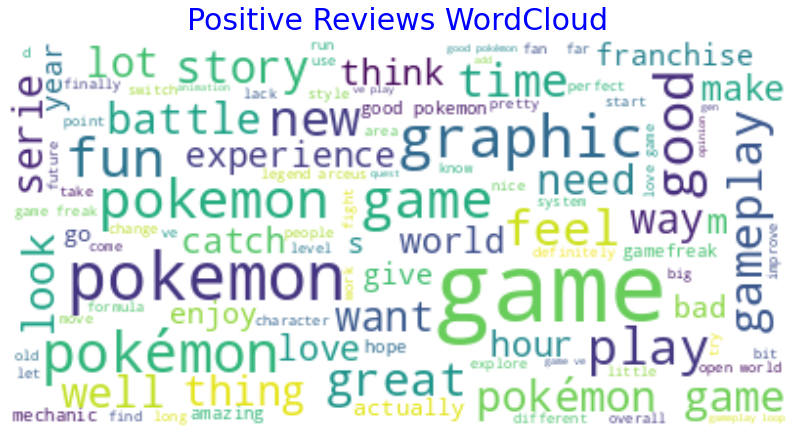

In [185]:
wordcl = WordCloud(background_color='white', max_font_size=50,
                   max_words=100).generate(pos_text)
plt.figure(figsize=(14, 12))
plt.imshow(wordcl, interpolation='bilinear')
plt.title("Positive Reviews WordCloud",
          pad=10.0,
          color='Blue',
          fontdict={'fontsize': 30})
plt.axis('off')
plt.show()

Let's get this into a function:

In [192]:
def class_wordcloud(c, max_w=100):
    '''
    Plot a wordcloud with a max of 100 words (max_w) by default.
    Plots words in classes listed in the list c - must be one of 'positive', 'negative' or 'mixed'
    '''
    text = " ".join(
        rev for rev in reviews_en[reviews_en['class'].isin(c)]['review_clean'])

    wordcl = WordCloud(background_color='white',
                       max_font_size=50,
                       max_words=max_w).generate(text)
    plt.figure(figsize=(14, 12))
    plt.imshow(wordcl, interpolation='bilinear')
    plt.title(",".join(c) + "'s WordCloud",
              pad=10.0,
              color='Blue',
              fontdict={'fontsize': 30})
    plt.axis('off')
    plt.show()

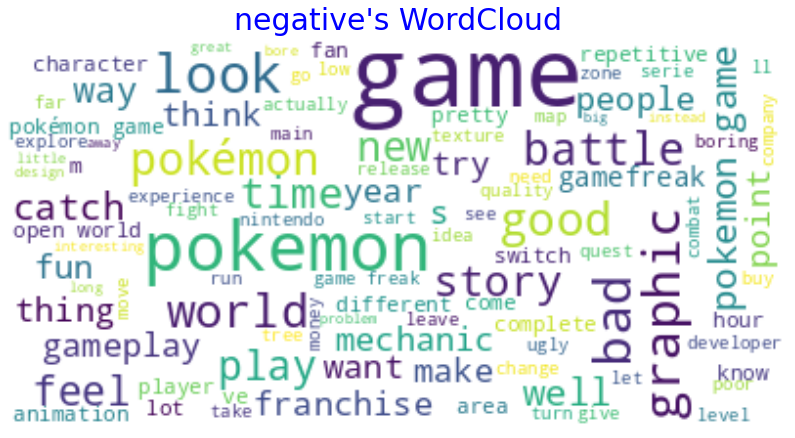

In [193]:
class_wordcloud(['negative'])

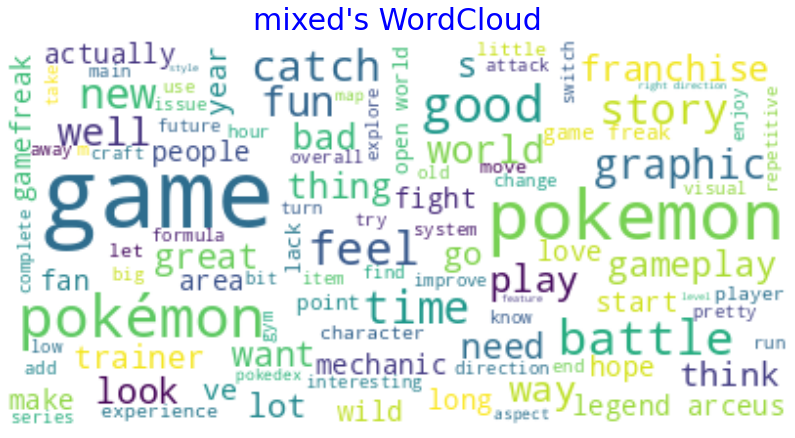

In [195]:
class_wordcloud(['mixed'])